In [2]:
import os
import sys
sys.path = ['/nfs/gns/homes/willj/anaconda3/envs/GTEx/lib/python3.5/site-packages'] + sys.path
GTEx_directory = '/hps/nobackup/research/stegle/users/willj/GTEx'
import openslide
from openslide.deepzoom import DeepZoomGenerator
from openslide import open_slide
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import scipy
import h5py

tissue = 'Lung'
# ID
tissue_filepath = os.path.join(GTEx_directory,'data','raw',tissue)
tissue_images = os.listdir(tissue_filepath)
tissue_IDs = [x.split('.')[0] for x in tissue_images]


In [3]:
ID = 'GTEX-145MF-0726'
with h5py.File(GTEx_directory + '/data/better_covering_patches/{}_128.hdf5'.format(ID),'r') as f:
    patches = f['patches'].value

In [4]:
with h5py.File(GTEx_directory + '/data/retrained_inceptionet_features.hdf5','r') as f:
    features = f['lung']['features']['128'][ID].value

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39


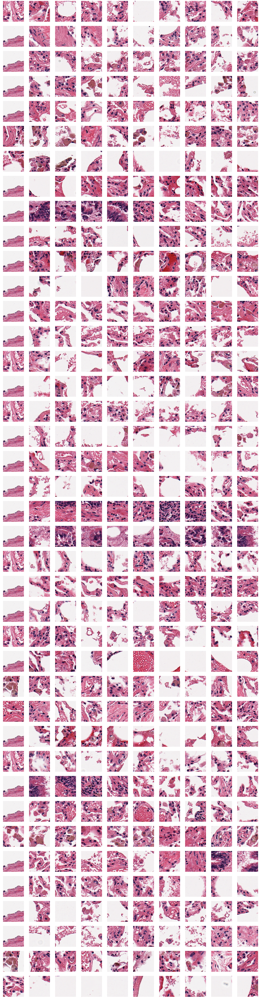

In [86]:
h = 10
v = 40

f, a = plt.subplots(v,h,figsize=(50,200))

for j in range(v):
    print (j)
    ordered_patches = patches[np.argsort(features[:,j])]

    for i in range(h):
        a[j][i].imshow(ordered_patches[i])
        a[j][i].axis('off')
        

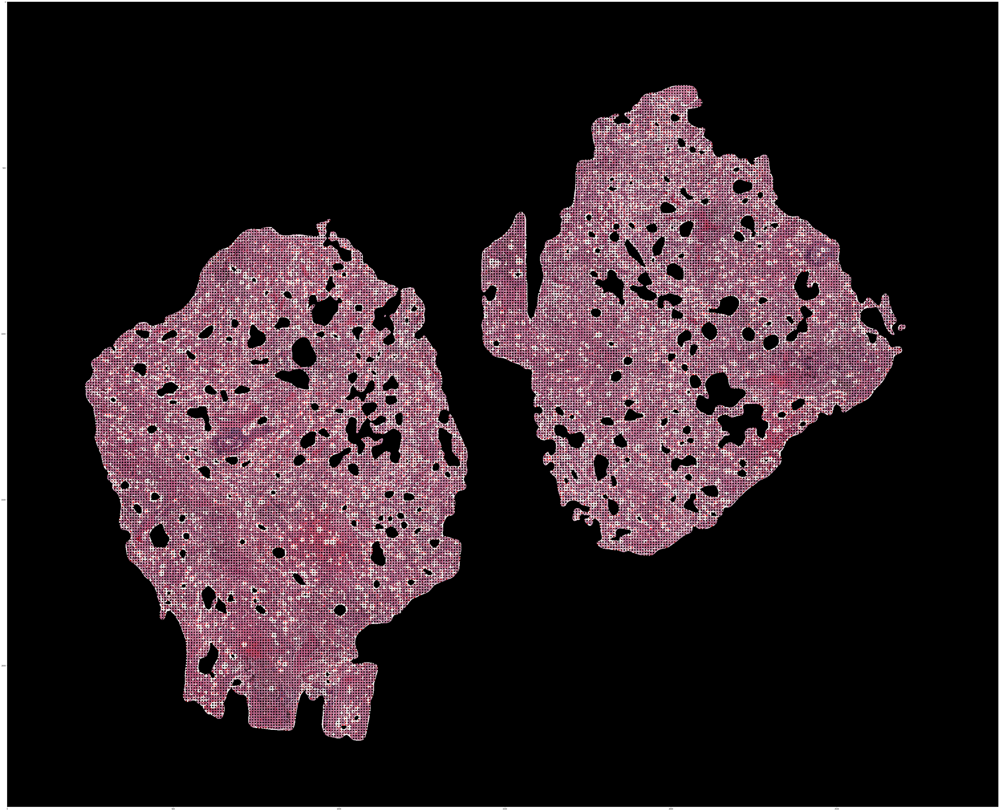

In [44]:
import cv2
from scipy.misc import imresize
import mahotas
import os
image_filepath = os.path.join(GTEx_directory,'data','raw',tissue, 'GTEX-145MF-0726.svs')

image_slide = open_slide(image_filepath)
# cv2.line(image_slide, (0,128), (200,128),color=[255,255,255], thickness=1)
toplevel = image_slide.level_count - 1
topdim = image_slide.level_dimensions[-1]
topdownsample = image_slide.level_downsamples[-1]
topdownsampleint = int(topdownsample)

toplevelslide = image_slide.read_region((0,0), toplevel, topdim)
toplevelslide = np.array(toplevelslide)
toplevelslide = toplevelslide[:,:,0:3]
slide = toplevelslide

blurredslide = cv2.GaussianBlur(slide, (51,51),0)
blurredslide = cv2.cvtColor(blurredslide, cv2.COLOR_BGR2GRAY)
T_otsu = mahotas.otsu(blurredslide)

mask = np.zeros_like(slide)
mask = mask[:,:,0]
mask[blurredslide < T_otsu] = 255

# plt.imshow(cv2.bitwise_and(slide, slide, mask=mask))

patchsize = 128
downsampledpatchsize = patchsize / topdownsampleint
xlimit = int(topdim[1] / downsampledpatchsize)
ylimit = int(topdim[0] / downsampledpatchsize)


# Find downsampled coords
coords = []
for i in range(xlimit):
    for j in range(ylimit):
        x = int(downsampledpatchsize/2 + i*downsampledpatchsize)
        y = int(downsampledpatchsize/2 + j*downsampledpatchsize)
        coords.append((x,y))

# Find coords in downsampled mask
mask_coords = []
for c in coords:
    x = c[0]
    y = c[1]
    if mask[x,y] > 0:
        mask_coords.append(c)
        
slidemarkings = slide.copy()
for (j,c) in enumerate(mask_coords):
    x = c[0]
    y = c[1]
    
    slidemarkings[x-2:x+2,y-2:y+2] = [(255*features[j]/max(features[j]))[517],0,0]
    
plt.figure(figsize=(100,100))
plt.imshow(cv2.bitwise_and(slidemarkings, slidemarkings, mask=mask))

In [47]:
# Convert downsampled masked coords to full masked coords
full_mask_coords = []
for c in mask_coords:
    x = c[0]
    y = c[1]
    full_x = int(topdownsample*x)
    full_y = int(topdownsample*y)
    full_mask_coords.append((full_x,full_y))

In [48]:
len(full_mask_coords)

31780

# Extract patches

Now, we want to extract the patches which are inside this boundary. Loosely, the algorithm runs as follows:
- Specify that patch size
- Enumerate all center pixels for each gridpatches across the image
- For each center pixel, decide whether or not it is in our thresholded regions
- If it is, save that patch.

However, when thresholding I am downsampling my image. Therefore, to ensure that I extract patches of the correct resolution for the full images, I need to make sure I calculate the correct patch centers.

In [15]:
from openslide.deepzoom import DeepZoomGenerator

tiles = DeepZoomGenerator(image_slide, tile_size=patchsize, overlap=0, limit_bounds=False)

covering_tiles = []
print (len(full_mask_coords))
for (i,full_coord) in enumerate(full_mask_coords):
    if i % 1000 == 0:
        print (i)
    x = int(full_coord[1] / patchsize)
    y = int(full_coord[0] / patchsize)
    tile = np.array(tiles.get_tile(tiles.level_count - 1,(x,y)))
    covering_tiles.append(tile)
    

9378
0
1000
2000
3000
4000
5000
6000
7000
8000
9000


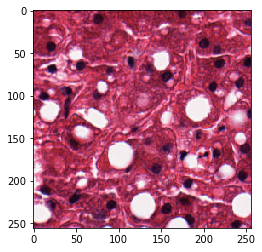

In [37]:
plt.imshow(covering_tiles[30])

In [414]:
patches.create_dataset('ID',data=covering_tiles)

<HDF5 dataset "ID": shape (432, 1024, 1024, 3), type "|u1">

In [ ]:
patches.creat

In [348]:
f = h5py.File('mytestfile.hdf5')
# lung = f.create_group('lung')
patches = f.create_group('lung/patches')
features = f.create_group('lung/features')
os.remove('mytestfile.hdf5')


In [321]:
f.create_group("lung/features/2048")


<HDF5 group "/lung/features/2048" (0 members)>

In [474]:
f = h5py.File('../../WillJdata.hdf5','w')

In [475]:
f.close()

In [470]:
g = h5py.File('../../WillJdata.hdf5','w')

OSError: Unable to create file (Unable to truncate a file which is already open)

In [432]:
x = f['lung']['patches']['128']

In [436]:
y = x['GTEX-OXRK-0926'].value